# Pokemon

Dataset from https://www.kaggle.com/datasets/djilax/pkmn-image-dataset

Idea based on HuggingFace diffusers https://github.com/huggingface/diffusers/tree/main/examples/unconditional_image_generation

In [ ]:
using Images
using Plots
using ProgressMeter
using StatsBase
using BSON, JSON
using Flux
using Random
using Printf

In [ ]:
using Revise
using DenoisingDiffusion 
using DenoisingDiffusion: train!, split_validation

In [ ]:
include("../common/utilities.jl");
include("../common/load_images.jl")

load_images (generic function with 1 method)

## Load

In [ ]:
data_directory="C:\\Users\\sinai\\Documents\\Projects\\datasets\\Pokemon\\32x32";

In [ ]:
data = load_images(data_directory)
size(data)

Progress: 100%|█████████████████████████████████████████| Time: 0:00:099m


(32, 32, 3, 7356)

In [ ]:
norm_data = normalize_neg_one_to_one(data);

In [ ]:
train_x, val_x = split_validation(MersenneTwister(2714), norm_data);
println("train_x: ", size(train_x))
println("val_x:   ", size(val_x))

train_x: (32, 32, 3, 6621)
val_x:   (32, 32, 3, 735)


## Data exploration

train set

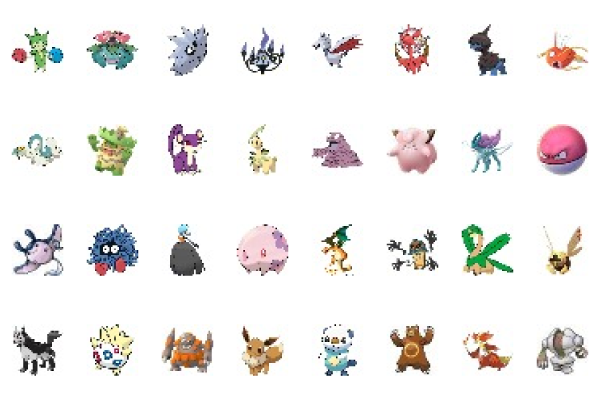

In [ ]:
nrows = 4
ncols = 8
canvases = []
for row in 1:nrows
    for col in 1:ncols
        idx = rand(1:n_train)
        img_WHC = train_x[:, :, :, idx]
        img_WHC = normalize_zero_to_one(img_WHC)
        img = img_WHC_to_rgb(img_WHC)
        push!(canvases, plot(img))
    end
end
plot(canvases..., layout=(nrows, ncols), ticks=nothing, showaxis=:off)

validation set

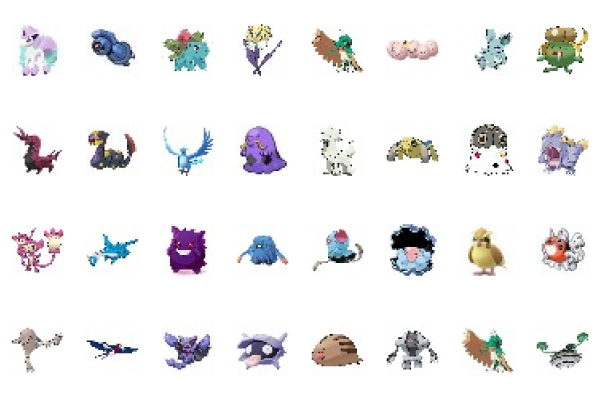

In [ ]:
nrows = 4
ncols = 8
canvases = []
idxs_val = sample(1:size(val_x, 4), nrows*ncols, replace=false)
for row in 1:nrows
    for col in 1:ncols
        idx = idxs_val[col + ncols * (row - 1)]
        img_WHC = val_x[:, :, :, idx]
        img_WHC = normalize_zero_to_one(img_WHC)
        img = img_WHC_to_rgb(img_WHC)
        push!(canvases, plot(img))
    end
end
plot(canvases..., layout=(nrows, ncols), ticks=nothing, showaxis=:off)

## Diffusion

In [ ]:
num_timesteps = 100
#βs = linear_beta_schedule(num_timesteps, 0.0001, 0.002) 
βs = cosine_beta_schedule(num_timesteps, 0.008)
data_shape = size(train_x)[1:3]
diffusion = GaussianDiffusion(Vector{Float32}, βs, (size(train_x)[1:3]..., ), identity)

GaussianDiffusion{Vector{Float32}}(num_timesteps=100, data_shape=(32, 32, 3), denoise_fn=identity, buffers_size=5.156 KiB)

In [ ]:
# idx = rand(1:n_train)
# img_WHC = train_x[:, :, :, idx][:, :, :, 1];
img_WHC = normalize_neg_one_to_one(data[:, :, :, 13]);

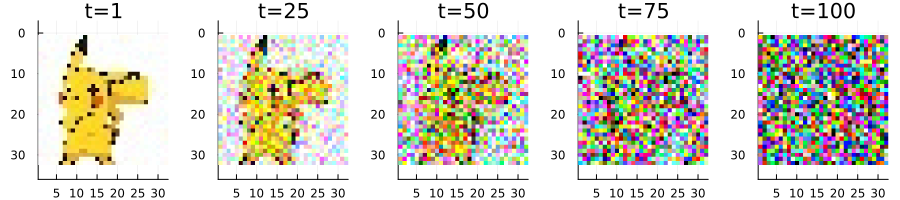

In [ ]:
canvases = []
for frac in [0.0, 0.25, 0.5, 0.75, 1]
    local p
    timestep = max(1, ceil(Int, frac * num_timesteps))
    Xt = q_sample(diffusion, img_WHC, timestep)
    clamp!(Xt, -one(Xt[1]), one(Xt[1]))
    Xt = normalize_zero_to_one(Xt)
    img = img_WHC_to_rgb(Xt)
    p = plot(img, title="t=$timestep")
    push!(canvases, p)
end

p = plot(canvases..., layout=(1, 5), link=:both, size=(900, 200))
#savefig("../outputs/pokemon_forward_mewtwo.png")
p

In [ ]:
XT = q_sample(diffusion, img_WHC, num_timesteps)
anim_forward = @animate for t ∈ 1:1:(num_timesteps + 20)
    if t < num_timesteps
        Xt = q_sample(diffusion, img_WHC, t)
    else
        Xt = XT
        t = num_timesteps
    end
    clamp!(Xt, -one(Xt[1]), one(Xt[1]))
    Xt = normalize_zero_to_one(Xt)
    img = img_WHC_to_rgb(Xt)
    p = plot(img, title="t=$t")
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_Ei5BWG", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000111.png", "000112.png", "000113.png", "000114.png", "000115.png", "000116.png", "000117.png", "000118.png", "000119.png", "000120.png"])

[ Info: Saved animation to C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\outputs\pokemon_forward.gif


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\outputs\\pokemon_forward.gif")
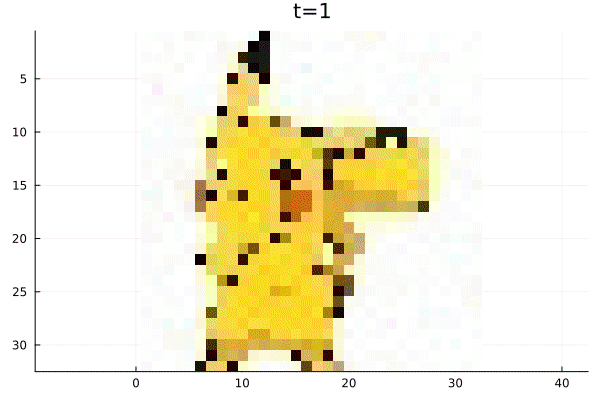

In [ ]:
gif(anim_forward, "../outputs/pokemon_forward.gif", fps=15)

## Test

In [ ]:
directory = "../models/Pokemon_20230827_32x32_1m";
diffusion_path = joinpath(directory, "model_epoch=40.bson");
history_path = joinpath(directory, "history.json");

In [ ]:
diffusion = BSON.load(diffusion_path)[:model]
println("data shape:    $(diffusion.data_shape)")
num_timesteps = diffusion.num_timesteps
println("num timesteps: $(num_timesteps)")
diffusion.denoise_fn

data shape:    (32, 32, 3)
num timesteps: 100


UNet(
  time_embedding = Chain(
    SinusoidalPositionEmbedding(100 => 128),
    Dense(128 => 128, gelu),            # 16_512 parameters
    Dense(128 => 128),                  # 16_512 parameters
  ),
  chain = ConditionalChain(
    init = Conv((3, 3), 3 => 32, pad=1),  # 896 parameters
    down_1 = ResBlock(
      in_layers = ConvEmbed(
        embed_layers = Chain(
          NNlib.swish,
          Dense(128 => 32),             # 4_128 parameters
        ),
        conv = Conv((3, 3), 32 => 32, pad=1),  # 9_248 parameters
        norm = GroupNorm(32, 8),        # 64 parameters
        activation = NNlib.swish,
      ),
      out_layers = Chain(
        Conv((3, 3), 32 => 32, pad=1),  # 9_248 parameters
        GroupNorm(32, 8),               # 64 parameters
        NNlib.swish,
      ),
      skip_transform = identity,
    ),
    skip_1 = ConditionalSkipConnection(
      ConditionalChain(
        downsample_1 = Conv((4, 4), 32 => 32, pad=1, stride=2),  # 16_416 parameters
        dow

In [ ]:
history = JSON.parsefile(history_path)

Dict{String, Any} with 4 entries:
  "epoch_size"      => 828
  "mean_batch_loss" => Any[0.534372, 0.220295, 0.172027, 0.144124, 0.129776, 0.…
  "batch_size"      => 8
  "val_loss"        => Any[0.24711, 0.192686, 0.158762, 0.136736, 0.125198, 0.1…

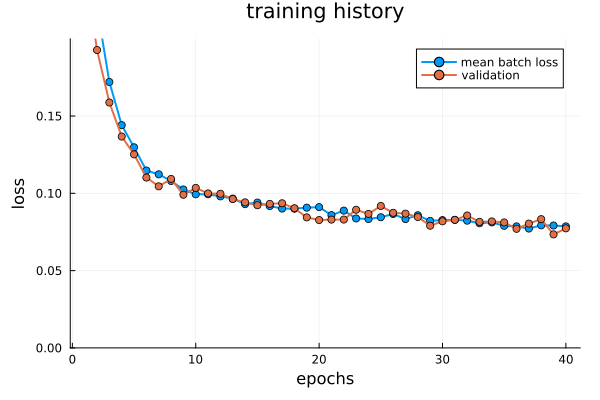

In [ ]:
epochs = 1:length(history["mean_batch_loss"])
steps = epochs * history["epoch_size"]
update_steps = steps / 32

canvas_train = plot(epochs, history["mean_batch_loss"], 
    label="mean batch loss", 
    title="training history",
    xlabel="epochs",
    ylabel="loss",
    ylims=(0, 0.2),
    linewidth=2,
    markershape=:circle,
    margin=3Plots.mm,
)
plot!(canvas_train, epochs, history["val_loss"], label="validation", linewidth=2, markershape=:circle)
savefig(canvas_train, joinpath(directory, "history.png"))
canvas_train

## Validate

In [ ]:
val_data = Flux.DataLoader(gpu(val_x); batchsize=32, shuffle=false);

In [ ]:
diffusion = gpu(diffusion);

In [ ]:
val_loss = 0.0
@showprogress for x in val_data
    global val_loss
    val_loss += p_losses(diffusion, Flux.mse, gpu(x); to_device=gpu)
end
val_loss /= length(val_data)
@printf("\nval loss: %.5f\n", val_loss)

Progress: 100%|█████████████████████████████████████████| Time: 0:00:03



val loss: 0.07729


### Sample

In [ ]:
Xs, X0s = p_sample_loop_all(diffusion, 6; to_device=gpu, clip_denoised=true) ;
Xs = cpu(Xs)
X0s = cpu(X0s)
size(X0s)

Sampling... 100%|████████████████████████████████████████| Time: 0:00:03


(32, 32, 3, 6, 100)

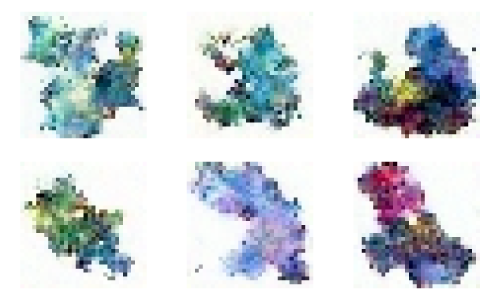

In [ ]:
num_images = size(Xs, 4)
imgs = Xs[:, :, :, :, end] |> normalize_zero_to_one |> img_WHC_to_rgb
canvas_samples = plot([plot(imgs[:, :, i]) for i in 1:num_images]..., showaxis=:off, ticks=:none, size=(500, 300))
savefig(canvas_samples, joinpath(directory, "samples.png"))
canvas_samples

DDIM Sampling... 100%|███████████████████████████████████| Time: 0:00:01


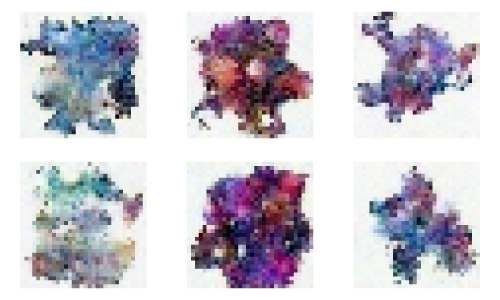

In [ ]:
Xs_ddim = ddim_sample_loop(diffusion, 50, 6; to_device=gpu, clip_denoised=true, η=1.0f0) ;
Xs_ddim = cpu(Xs_ddim)
num_images = size(Xs_ddim, 4)
imgs = Xs_ddim[:, :, :, :, end] |> normalize_zero_to_one |> img_WHC_to_rgb
canvas_samples = plot([plot(imgs[:, :, i]) for i in 1:num_images]..., showaxis=:off, ticks=:none, size=(500, 300))
canvas_samples

In [ ]:
anim_denoise = @animate for t ∈ 1:(num_timesteps + 15)
    t = t > num_timesteps ? num_timesteps : t
    imgs = Xs[:, :, :, :, t] |> normalize_zero_to_one |> img_WHC_to_rgb
    p = plot(
        [plot(imgs[:, :, i]) for i in 1:num_images]..., 
        showaxis=:off, 
        ticks=:none, 
        size=(500, 300),
        plot_title="$t",
    )
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_UZYgl3", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000106.png", "000107.png", "000108.png", "000109.png", "000110.png", "000111.png", "000112.png", "000113.png", "000114.png", "000115.png"])

[ Info: Saved animation to C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\models\Pokemon_20230827_32x32_1m\reverse_pokemon.gif


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\models\\Pokemon_20230827_32x32_1m\\reverse_pokemon.gif")
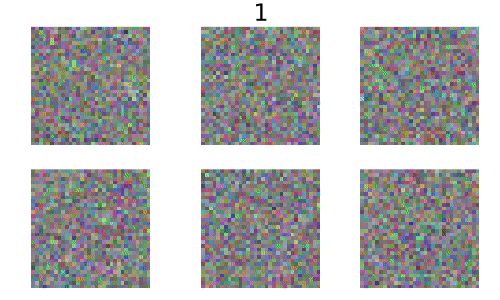

In [ ]:
gif(anim_denoise, joinpath(directory, "reverse_pokemon.gif"), fps=15)

In [ ]:
anim_estimates = @animate for t ∈ 1:(num_timesteps + 15)
    t = t > num_timesteps ? num_timesteps : t
    imgs = X0s[:, :, :, :, t] |> normalize_zero_to_one |> img_WHC_to_rgb
    p = plot(
        [plot(imgs[:, :, i]) for i in 1:num_images]..., 
        showaxis=:off, 
        ticks=:none, 
        size=(500, 300),
        plot_title="$t",
    )
end

Animation("C:\\Users\\sinai\\AppData\\Local\\Temp\\jl_iBi4uD", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000106.png", "000107.png", "000108.png", "000109.png", "000110.png", "000111.png", "000112.png", "000113.png", "000114.png", "000115.png"])

[ Info: Saved animation to C:\Users\sinai\Documents\Projects\Julia projects\DenoisingDiffusion-examples\models\Pokemon_20230827_32x32_1m\estimates_pokemon.gif


Plots.AnimatedGif("C:\\Users\\sinai\\Documents\\Projects\\Julia projects\\DenoisingDiffusion-examples\\models\\Pokemon_20230827_32x32_1m\\estimates_pokemon.gif")
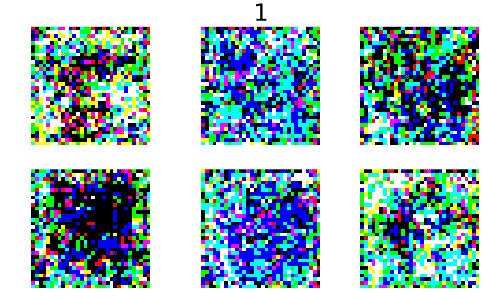

In [ ]:
gif(anim_estimates, joinpath(directory, "estimates_pokemon.gif"), fps=15)